In [81]:
import meep as mp
import matplotlib.pyplot as plt

     block, center = (0,0,0)
          size (1e+20,1e+20,0.4)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (10.9144,10.9144,10.9144)
     cylinder, center = (0,0,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,-0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-0.5,-0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)


     block, center = (0,0,0)
          size (1e+20,1e+20,0.4)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (10.9144,10.9144,10.9144)
     cylinder, center = (0,0,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,-0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-0.5,-0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)


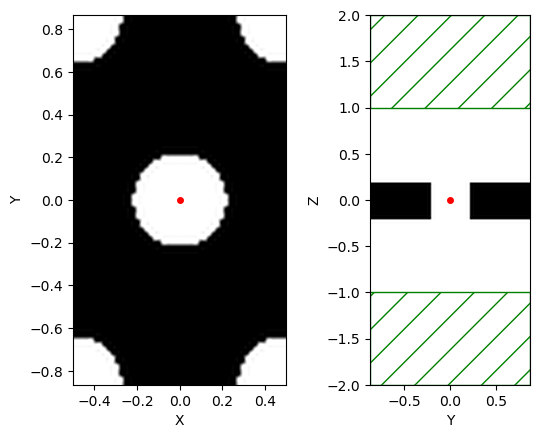

In [82]:
out_file='fourier_field_cal.log'
r=0.221
a = 1 # normalized a
dpml = 1*a

k = r
thick_ness = 0.4*a
sz = 0.4*a*5+2*dpml
resolution = 50

pml_layers = [mp.PML(dpml, direction=mp.Z)]

geometry = [mp.Block(size=mp.Vector3(mp.inf,mp.inf,thick_ness),material=mp.Medium(epsilon=3.3037**2)),
        mp.Cylinder(k*a, height=thick_ness, material=mp.Medium(epsilon=1)),
        mp.Cylinder(k*a, center=mp.Vector3(0.5*a, 3**0.5*a/2), height=thick_ness , material=mp.Medium(epsilon=1)),
        mp.Cylinder(k*a, center=mp.Vector3(0.5*a, -3**0.5*a/2), height=thick_ness ,material=mp.Medium(epsilon=1)),
        mp.Cylinder(k*a, center=mp.Vector3(-0.5*a, 3**0.5*a/2), height=thick_ness ,material=mp.Medium(epsilon=1)),
        mp.Cylinder(k*a, center=mp.Vector3(-0.5*a, -3**0.5*a/2), height=thick_ness ,material=mp.Medium(epsilon=1)),]

fcen = 0.71
df = 0.15
sources = [mp.Source(mp.GaussianSource(fcen, fwidth=df), component=mp.Hz, center=mp.Vector3(0,0))]
symmetry = [mp.Mirror(direction=mp.Z, phase=1),]#mp.Mirror(direction=mp.X, phase=1),]#mp.Mirror(direction=mp.Y, phase=-1)]

sim = mp.Simulation(cell_size=mp.Vector3(a, 3**0.5*a, sz),
                boundary_layers=pml_layers,
                geometry=geometry,
                sources=sources,
                resolution=resolution,
                symmetries=symmetry,
                )
resonance_fr = mp.FluxRegion(center=mp.Vector3(0,0,thick_ness/2+0.5*a),size=mp.Vector3(a,3**0.5*a),direction=mp.Z)

ax1 = plt.subplot(121) 
ax1 = mp.plot2D(sim,output_plane=mp.Volume(size=mp.Vector3(mp.inf,mp.inf)))
ax2 = plt.subplot(122) 
fig = mp.plot2D(sim,output_plane=mp.Volume(size=mp.Vector3(0,mp.inf,mp.inf)))
plt.show()

In [83]:
sim.run((mp.after_sources(mp.Harminv(mp.Hz, mp.Vector3(0.05), fcen, 2*df))),         
        until=100 / fcen)
resonance_z = sim.add_flux(fcen, df, 201, resonance_fr)
near_fields = sim.add_dft_fields([mp.Hz], fcen, df/4, 201, center=mp.Vector3(z=thick_ness/2+0.5*a), size=mp.Vector3(a,3**0.5*a))
sim.run((mp.after_sources(mp.Harminv(mp.Hz, mp.Vector3(0.05), fcen, 2*df))),         
        until=1500 / fcen)
sim.run(mp.in_volume(mp.Volume(center=mp.Vector3(z=thick_ness/4),size=mp.Vector3(a,3**0.5*a)),
                mp.to_appended("Hz", mp.at_every(1 / fcen / 20, mp.output_hfield_z)),
                mp.to_appended("Ex", mp.at_every(1 / fcen / 20, mp.output_efield_x)),
                mp.to_appended("Ey", mp.at_every(1 / fcen / 20, mp.output_efield_y)),
                ), 
        until=1 / fcen)
sim.save_flux('flux',resonance_z)
sim.output_dft(near_fields,'near_fields')

-----------
Initializing structure...
Halving computational cell along direction z
time for choose_chunkdivision = 0.000445127 s
Working in 3D dimensions.
Computational cell is 1 x 1.74 x 4 with resolution 50
     block, center = (0,0,0)
          size (1e+20,1e+20,0.4)
          axes (1,0,0), (0,1,0), (0,0,1)
          dielectric constant epsilon diagonal = (10.9144,10.9144,10.9144)
     cylinder, center = (0,0,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (0.5,-0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = (-0.5,0.866025,0)
          radius 0.221, height 0.4, axis (0, 0, 1)
          dielectric constant epsilon diagonal = (1,1,1)
     cylinder, center = 

/home/maple/anaconda3/envs/pmp/lib/python3.11/site-packages/meep/simulation.py:979: RuntimeWarning:

Harminv frequency 0.86 is outside maximum Source frequency 0.7849999999999999

/home/maple/anaconda3/envs/pmp/lib/python3.11/site-packages/meep/simulation.py:982: RuntimeWarning:

Harminv frequency 0.5599999999999999 is outside minimum Source frequency 0.635



on time step 14345 (time=143.45), 0.00639682 s/step
Meep progress: 6.549993896484381/2253.526062441544 = 0.3% done in 4.0s, 1373.5s to go
on time step 14979 (time=149.79), 0.00631017 s/step
Meep progress: 12.979993896484388/2253.526062441544 = 0.6% done in 8.0s, 1381.9s to go
on time step 15656 (time=156.56), 0.00591113 s/step
Meep progress: 19.619993896484374/2253.526062441544 = 0.9% done in 12.0s, 1367.2s to go
on time step 16284 (time=162.84), 0.00637073 s/step
Meep progress: 26.219993896484368/2253.526062441544 = 1.2% done in 16.0s, 1359.9s to go
on time step 17001 (time=170.01), 0.0055833 s/step
Meep progress: 33.419993896484385/2253.526062441544 = 1.5% done in 20.0s, 1329.3s to go
on time step 17694 (time=176.94), 0.00577555 s/step
Meep progress: 40.419993896484385/2253.526062441544 = 1.8% done in 24.0s, 1314.9s to go
on time step 18420 (time=184.2), 0.00551395 s/step
Meep progress: 47.34999389648439/2253.526062441544 = 2.1% done in 28.0s, 1305.4s to go
on time step 19072 (time=1

In [84]:
z_flux = mp.get_fluxes(resonance_z)
flux_freqs = mp.get_flux_freqs(resonance_z)

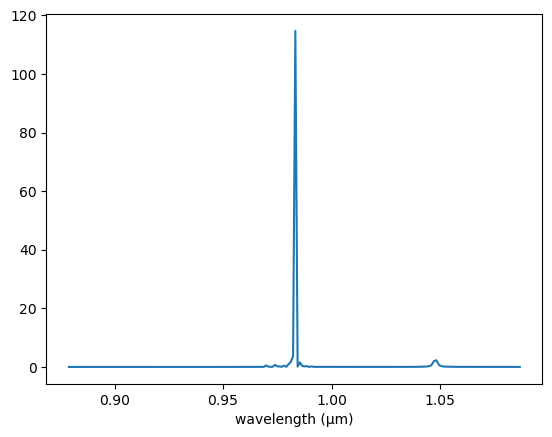

In [88]:
import numpy as np
wl = []
Ts = []
for i in range(len(flux_freqs)):
    wl = np.append(wl, 0.69 / flux_freqs[i])
    Ts = np.append(Ts, z_flux[i])
plt.plot(wl,Ts)
plt.xlabel("wavelength (μm)")
plt.show()

In [86]:
[x,y,z,w] = sim.get_array_metadata(dft_cell=near_fields)

In [87]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
i = 0
for step in near_fields.freq:
    radiation_dft = sim.get_dft_array(near_fields, mp.Hz, i)
    radiation_amplitude = np.real(radiation_dft)
    fig.add_trace(
        go.Heatmap(z=np.rot90(radiation_amplitude),
                   zmid=0,
                   visible=False,
                   name="freq = " + str(step),
                   x=x, y=y, colorscale='RdBu_r',
                   type='heatmap')
            )
    i += 1

# Make 10th trace visible
fig.data[0].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to frequency: " + str(flux_freqs[i])}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=10,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    margin=dict(autoexpand=False),
    sliders=sliders,
    xaxis = dict(autorange = True, scaleanchor = 'y'),
    yaxis = dict(autorange = True),
    #autosize = True,
    width = 700,
    height = 600,
)

fig.show()